In [1]:
import pandas as pd
import cv2
import os
import matplotlib.pyplot as plt
import glob
import shutil
from pathlib import Path
import seaborn as sns
import numpy as np
import math
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.colors as mcolors
from collections import defaultdict

## Segment Images Algorithm

Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000001.tif...
Extracted 233 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000001.tif.


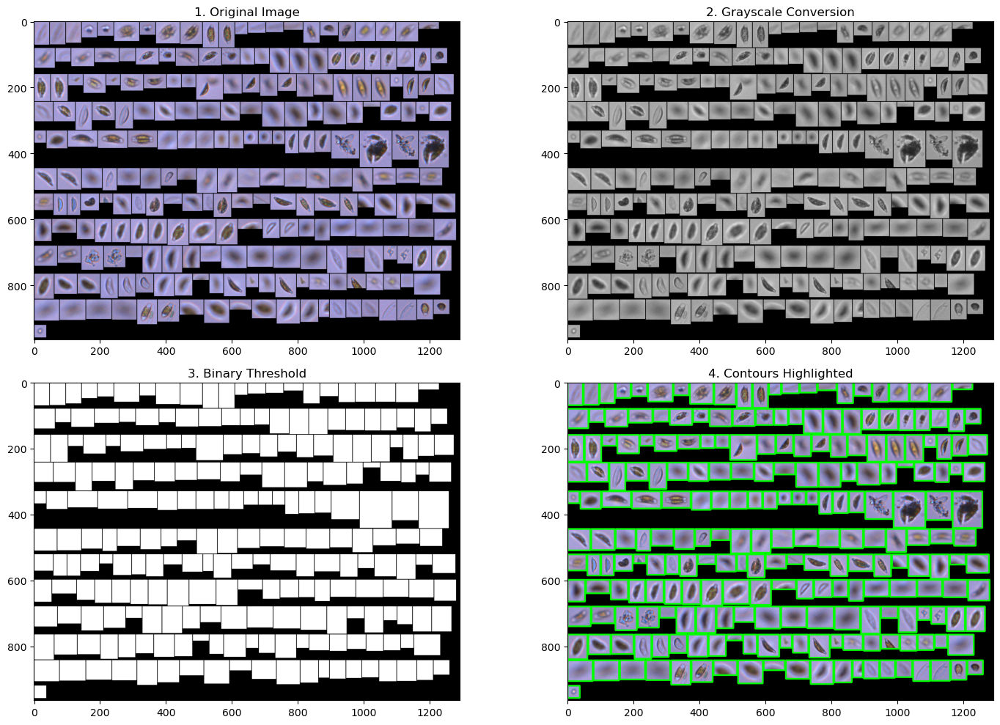

Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000002.tif...
Extracted 206 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000002.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000003.tif...
Extracted 206 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000003.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000004.tif...
Extracted 147 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000004.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000005.tif...
Extracted 211 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000005.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000006.tif...
Extracted 178 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000006.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000007.tif...
Extracted 212 images from data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000007.tif.
Processing data\IN-2A\IN2-A 08-16-23 1-100 Dilution_000008.tif...
Extracted 156 images from data\IN-2A\IN2-A 08-16-23 1-100 Diluti

In [2]:
def segment_image(input_dir, output_dir, min_area=100):
    """
    Processes .tif files (except binary) in the input directory, extracting cell images from each
    and saving them in sorted order in the output directory.

    Currently takes ONE directory and outputs to ONE directory

    Hardcoded the label (WK1-..., WK2-..., IN-...)

    Parameters:
    - input_dir: The directory containing the .tif files to process.
    - output_dir: The directory where the rectangle images will be saved.
    - min_area: The minimum area threshold for a contour to be considered a valid rectangle.
    
    Returns:
    - extracted_counts: A dictionary with file numbers as keys and the count of extracted images as values.
    """
    # ensure the output directory exists
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)

    # initialize a counter for the filenames
    file_counter = 1
    # initialize a dictionary for the counts
    extracted_counts = {}

    # get all .tif files in the input directory
    tif_files = sorted(glob.glob(os.path.join(input_dir, '*.tif')))

    for tif_file in tif_files:
        # filter binary images
        if "bin" in tif_file:
            continue

        # read the image
        image = cv2.imread(tif_file)

        # extract the file number from the filename
        file_number = tif_file.split('_')[-1].split('.')[0]

        print(f"Processing {tif_file}...")
        
        # convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # apply a binary threshold to get cell image areas
        _, binary_threshold = cv2.threshold(gray_image, 1, 255, cv2.THRESH_BINARY)

        # find contours of the cell image areas
        contours, _ = cv2.findContours(binary_threshold, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # filter out contours that are too small
        valid_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > min_area]

        # sort contours based on the position of their bounding box's top-left corner
        sorted_contours = sorted(valid_contours, key=lambda cnt: (cv2.boundingRect(cnt)[1], cv2.boundingRect(cnt)[0]))

        images_from_current_tif = 0
        # extract and save the rectangles
        for i, contour in enumerate(sorted_contours):
            x, y, w, h = cv2.boundingRect(contour)
            sorted_extracted_image = image[y:y+h, x:x+w]
            file_path = os.path.join(output_dir, f'IN-2A_{str(file_counter).zfill(6)}.png')
            cv2.imwrite(file_path, sorted_extracted_image)
            file_counter += 1
            images_from_current_tif += 1
        
        # save the count for the current file
        extracted_counts[file_number] = images_from_current_tif

        print(f"Extracted {images_from_current_tif} images from {tif_file}.")
        if tif_file == tif_files[0]:
            plt.figure(figsize=(15, 10))

            plt.subplot(2, 2, 1)
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.title('1. Original Image')

            plt.subplot(2, 2, 2)
            plt.imshow(gray_image, cmap='gray')
            plt.title('2. Grayscale Conversion')

            plt.subplot(2, 2, 3)
            plt.imshow(binary_threshold, cmap='gray')
            plt.title('3. Binary Threshold')

            # Drawing contours on a copy of the original image
            contour_image = image.copy()
            cv2.drawContours(contour_image, sorted_contours, -1, (0, 255, 0), 3)

            plt.subplot(2, 2, 4)
            plt.imshow(cv2.cvtColor(contour_image, cv2.COLOR_BGR2RGB))
            plt.title('4. Contours Highlighted')

            plt.tight_layout()
            plt.savefig('image_processing_steps.png')
            plt.show()
    return extracted_counts

input_directory = 'data\IN-2A' # hard coded to run through one folder of the images
output_directory = 'data\IN-All-Split\IN-2A' # output to new folder
extracted_counts = segment_image(input_directory, output_directory)


### Load .lst as Pandas DF

In [3]:
"""
Load one .lst as a Pandas Dataframe
"""

file_path = 'data\IN-2A\IN2-A 08-16-23 1-100 Dilution.lst' # hard coded to load one .lst

# number of metadata lines to skip (57 column header definitions)
skip_rows = 58

# column headers at top of .lst file
column_names = [
    'id', 'image_x', 'image_y', 'image_w', 'image_h', 'src_x', 'src_y', 'src_image',
    'cal_image', 'ppc', 'camera', 'cal_const', 'fringe_size', 'sphere_count',
    'raw_sphere_volume', 'raw_sphere_complement', 'raw_sphere_unknown', 'raw_area',
    'raw_feret_max', 'raw_feret_min', 'raw_feret_mean', 'raw_perimeter',
    'raw_convex_perimeter', 'raw_legendre_major', 'raw_legendre_minor', 'abd_area',
    'abd_diameter', 'length', 'width', 'esd_diameter', 'fd_diameter', 'perimeter',
    'convex_perimeter', 'intensity', 'sigma_intensity', 'sum_intensity', 'compactness',
    'elongation', 'roughness', 'edge_gradient', 'elapsed_time', 'circle_fit',
    'symmetry', 'circularity_hu', 'intensity_calimage', 'raw_convex_hull_area',
    'raw_filled_area', 'filled_area', 'feret_max_angle', 'feret_min_angle',
    'avg_red', 'avg_green', 'avg_blue', 'timestamp', 'collage_file', 'image_id'
]

df = pd.read_csv(file_path, delimiter='|', skiprows=skip_rows, header=None, names=column_names)

# save in our happy format
# df.to_csv('IN-2A_df.csv', index=False)

#df

#### Verify Segmentation Count vs Actual Image Count

In [4]:
# """
# Compare loaded .lst to what our segment_image function outputs (extracted_counts)

# Show new df that shows True Count vs Count from function and the difference for both
# (+ means extra images, - means missing images)
# """

# # convert the dictionary from algorithm to Dataframe
# df_counts = pd.DataFrame(list(extracted_counts.items()), columns=['.tif', 'counts'])

# df_counts.set_index('.tif', inplace=True)

# # extract the file numbers from 'collage_file' into a new column
# df['file_number'] = df['collage_file'].str.extract('_(\d+)\.tif').astype(int)

# # count the occurrences of each file number
# file_counts = df.groupby('file_number').size()

# # create a new DataFrame with the file number as the index and the counts as a column
# df_file_counts = file_counts.reset_index(name='True Count')
# df_file_counts.set_index('file_number', inplace=True)

# # make sure that the index of df_file_counts is of type int
# df_file_counts.index = df_file_counts.index.astype(int)

# # join the 'counts' column from df_counts to df_file_counts
# df_final = df_file_counts

# df_final["Count from Algorithm"] = df_counts["counts"].values # add col

# df_final['Difference'] = df_final['True Count'] - df_final['Count from Algorithm']

# df_final

## Filter Out Empty Images

### EDA of Images

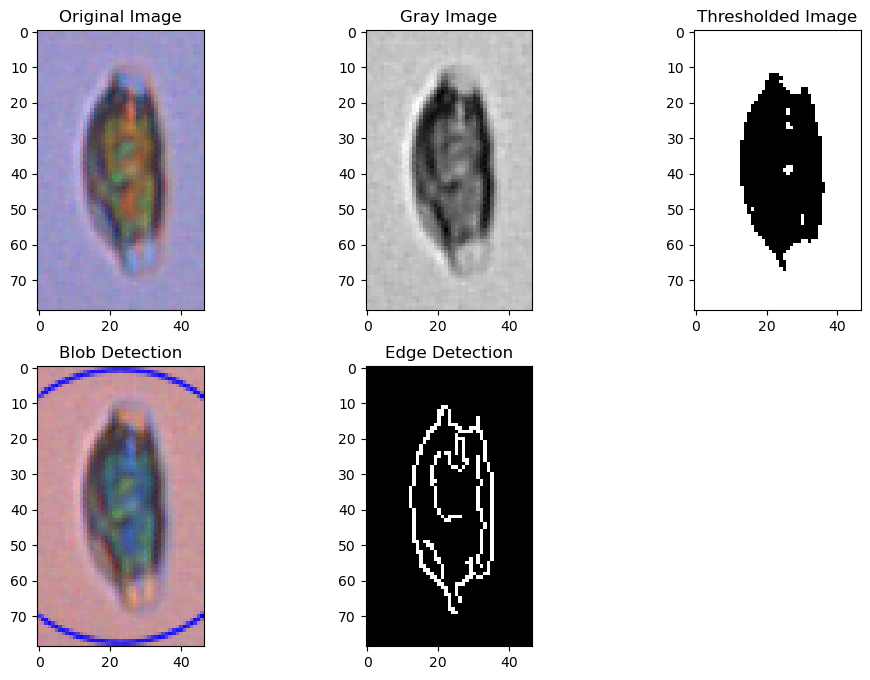

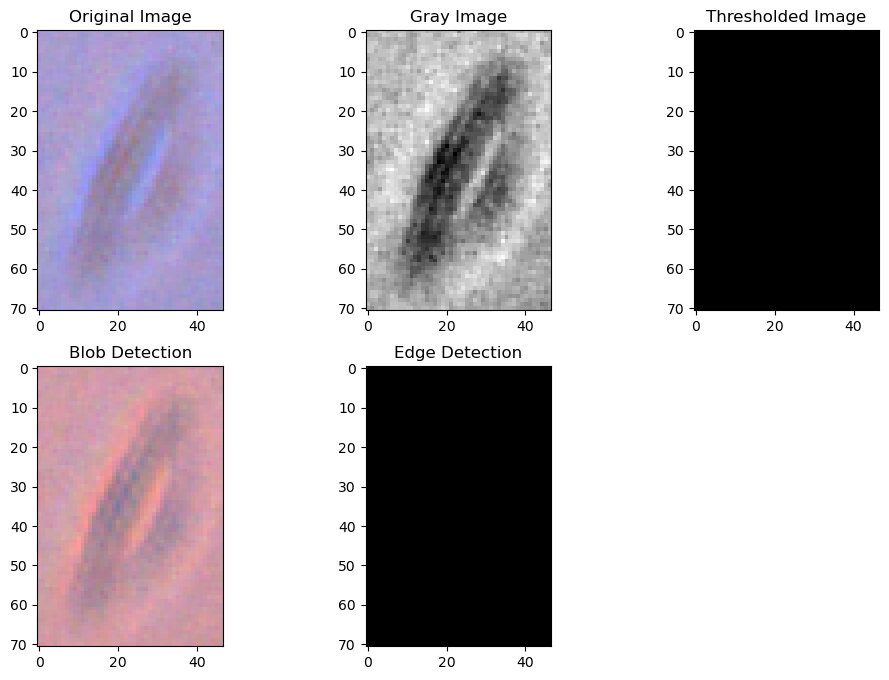

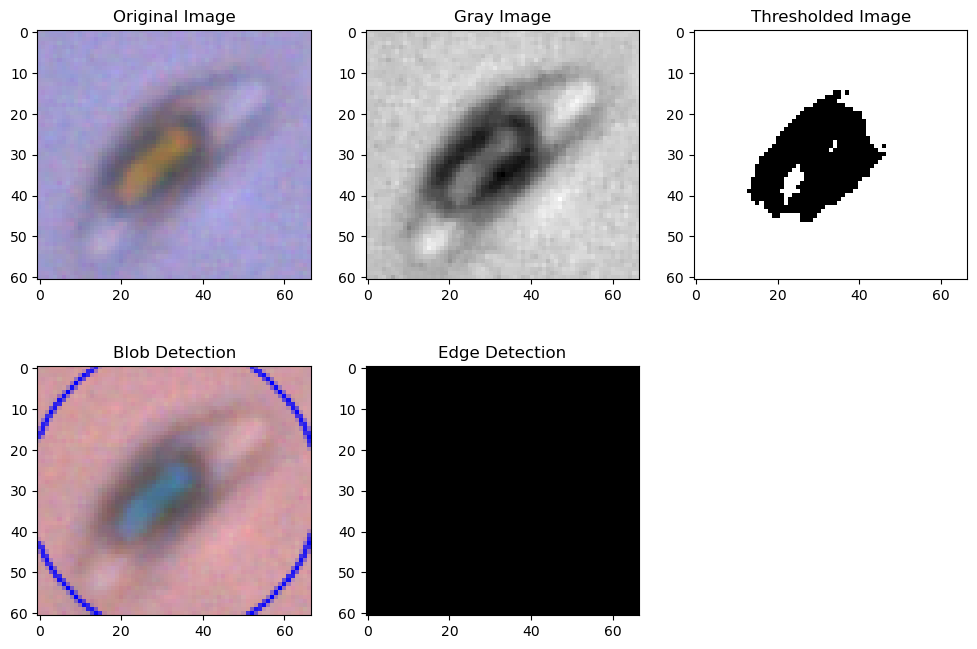

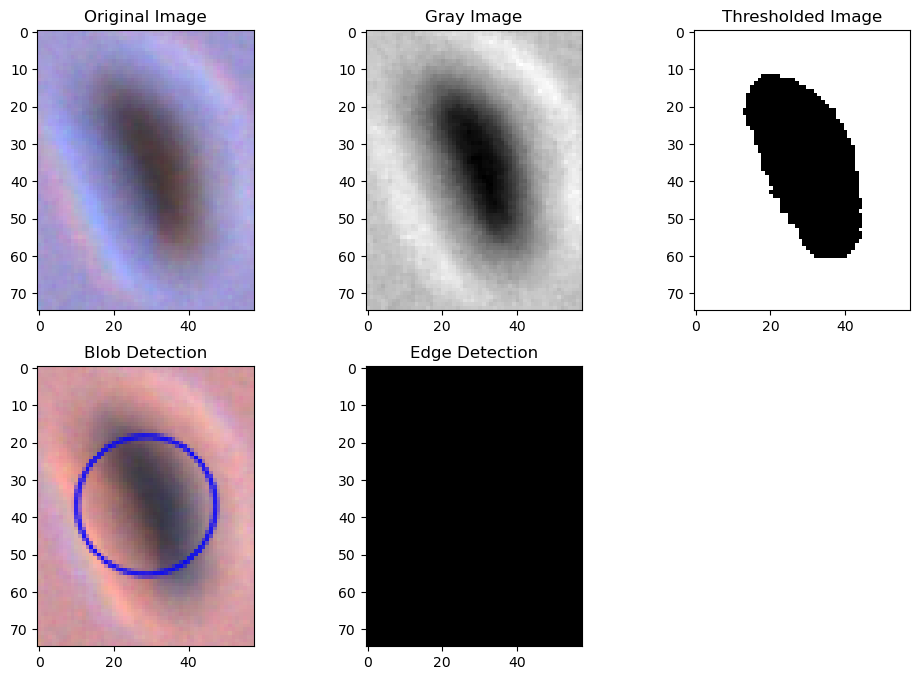

In [5]:
"""
EDA of the images and how they respond to different CV algorithms
"""

def visualize_filter_options(image_path):
    # load the image
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)

    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # thresholding
    _, thresh = cv2.threshold(gray, 128, 255, cv2.THRESH_BINARY)

    # blob Detection
    params = cv2.SimpleBlobDetector_Params()
    params.filterByArea = True
    params.minArea = 100
    detector = cv2.SimpleBlobDetector_create(params)
    keypoints = detector.detect(thresh)

    # draw detected blobs as red circles
    blobs = cv2.drawKeypoints(image, keypoints, None, (0, 0, 255), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # edge detection
    edges = cv2.Canny(gray, 100, 200)

    # histogram analysis (wasnt much to learn from histogram for this case)
    #plt.figure()
    #plt.hist(gray.ravel(), 256, [0, 256])
    #plt.title("Histogram for Gray Scale Image")

    # display
    plt.figure(figsize=(12, 8))
    plt.subplot(231), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
    plt.subplot(232), plt.imshow(gray, cmap='gray'), plt.title('Gray Image')
    plt.subplot(233), plt.imshow(thresh, cmap='gray'), plt.title('Thresholded Image')
    plt.subplot(234), plt.imshow(blobs), plt.title('Blob Detection')
    plt.subplot(235), plt.imshow(edges, cmap='gray'), plt.title('Edge Detection')
    plt.show()

img_1 = "G:\My Drive\School\cs4347\jjp176\project\data\IN-All-Split\IN-2A\IN-2A_000011.png" # obvious cell
img_2 = "G:\My Drive\School\cs4347\jjp176\project\data\IN-All-Split\IN-2A\IN-2A_000001.png" # obvious blank
img_3 = "G:\My Drive\School\cs4347\jjp176\project\data\IN-All-Split\IN-2A\IN-2A_000021.png" # possible outlier? (need to know if Emma would keep this in her manual annotations)
img_4 = "G:\My Drive\School\cs4347\jjp176\project\data\IN-All-Split\IN-2A\IN-2A_000035.png" # blob detection catches images we do not want
visualize_filter_options(img_1)
visualize_filter_options(img_2)
visualize_filter_options(img_3)
visualize_filter_options(img_4)

### EDA of CSV Data

#### Outlier Detection from CSV Data

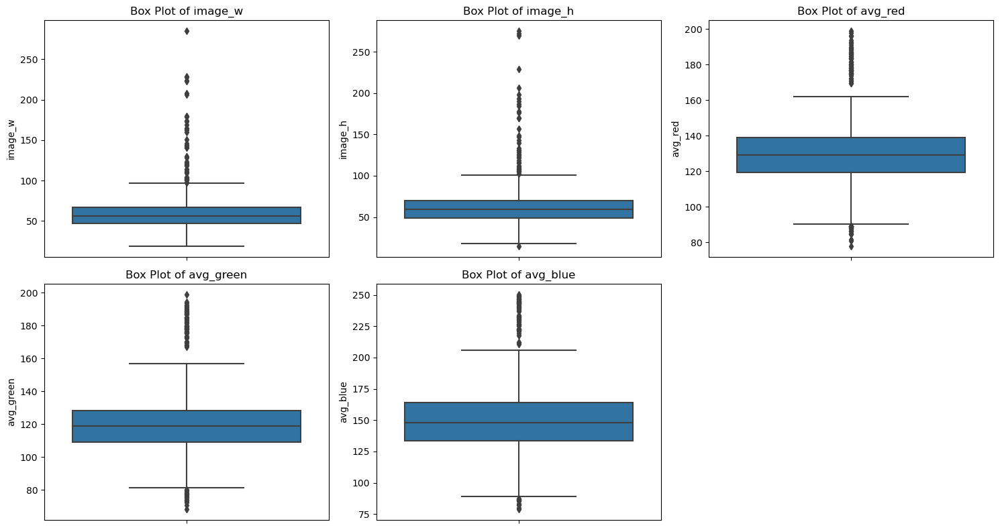

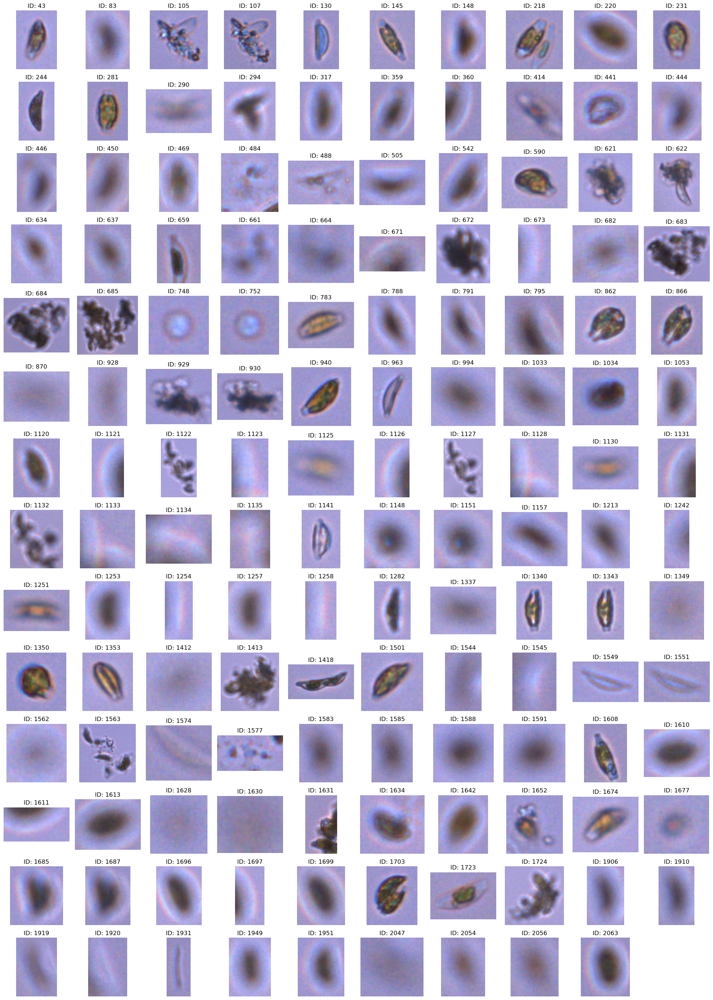

In [6]:
"""
Did not amount to much, outliers are sometimes cells we want to "keep" I think.
"""

def detect_outliers(df, features):
    outlier_indices = []

    for c in features:
        # 1st quartile (25%)
        Q1 = df[c].quantile(0.25)
        # 3rd quartile (75%)
        Q3 = df[c].quantile(0.75)
        # interquartile range
        IQR = Q3 - Q1

        # outlier step
        outlier_step = 1.5 * IQR

        # determine a list of indices of outliers for feature c
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index

        # append the found outlier indices for c to the list of outlier indices
        outlier_indices.extend(outlier_list_col)

    # select observations containing more than 2 outliers
    outlier_indices = list(set(outlier_indices))
    return outlier_indices


# plotting box plots for the features and then detecting outliers
features_to_plot = ['image_w', 'image_h', 'avg_red', 'avg_green', 'avg_blue']

plt.figure(figsize=(15, 8))
for i, feature in enumerate(features_to_plot, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(y=df[feature])
    plt.title(f'Box Plot of {feature}')

plt.tight_layout()
plt.show()

outliers = detect_outliers(df, features_to_plot)
outliers.sort() # order

image_directory = 'data\\IN-All-Split\\IN-2A'

fig, axes = plt.subplots(14, 10, figsize=(20, 28))

# iterate over each subplot and display the corresponding image
for i, ax in enumerate(axes.flatten()):
    if i < len(outliers):
        image_id = outliers[i]
        image_path = os.path.join(image_directory, f'IN-2A_{str(image_id).zfill(6)}.png')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax.imshow(image)
        ax.set_title(f'ID: {image_id}')
        ax.axis('off')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()


#### Correlation

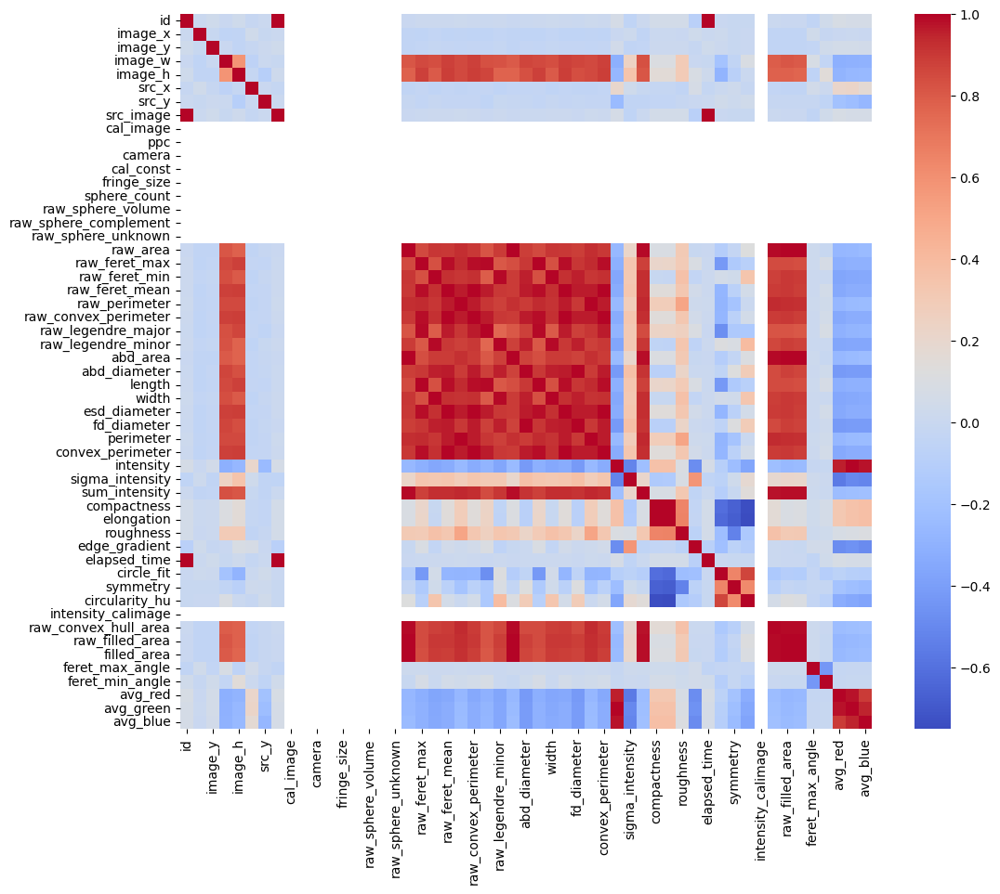

In [7]:
# filter out non-numerical columns
numeric_df = df.select_dtypes(include=[np.number])

# correlation matrix
correlation_matrix = numeric_df.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False, fmt=".1f")
plt.show()
correlation_matrix.to_csv('cm.csv')

### T-SNE

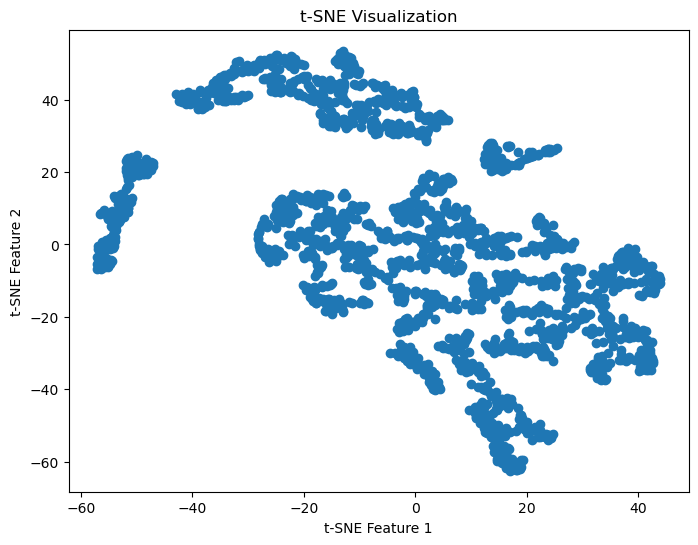

In [8]:
"""
Naked T-SNE
"""

# selecting shape and texture features for analysis
features = ['circularity_hu', 'raw_convex_hull_area']  # Replace with your actual features

# standardizing the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df[features])

# applying t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=0)
tsne_results = tsne.fit_transform(scaled_features)

# plotting the results of t-SNE
plt.figure(figsize=(8, 6))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1])
plt.title("t-SNE Visualization")
plt.xlabel("t-SNE Feature 1")
plt.ylabel("t-SNE Feature 2")
plt.show()


c:\Users\trist\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


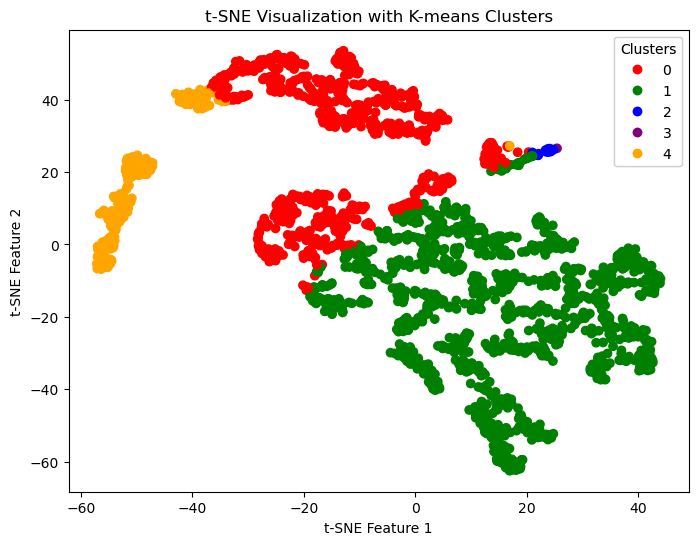

In [9]:
"""
t-SNE with K-Means (discrete legend)
"""
# selecting shape and texture features for analysis
features = ['circularity_hu', 'raw_convex_hull_area']

# standardizing the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df[features])

# apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=0)
clusters = kmeans.fit_predict(scaled_features)

# apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=0)
tsne_results = tsne.fit_transform(scaled_features)

# plotting the results of t-SNE with cluster labels
plt.figure(figsize=(8, 6))

# define discrete colormap
colors = ['red', 'green', 'blue', 'purple', 'orange']
cmap = mcolors.ListedColormap(colors)

# scatter plot
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=clusters, cmap=cmap)

# create a legend
legend1 = plt.legend(*scatter.legend_elements(),
                    loc="upper right", title="Clusters")
plt.gca().add_artist(legend1)

plt.title("t-SNE Visualization with K-means Clusters")
plt.xlabel("t-SNE Feature 1")
plt.ylabel("t-SNE Feature 2")
plt.show()

c:\Users\trist\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


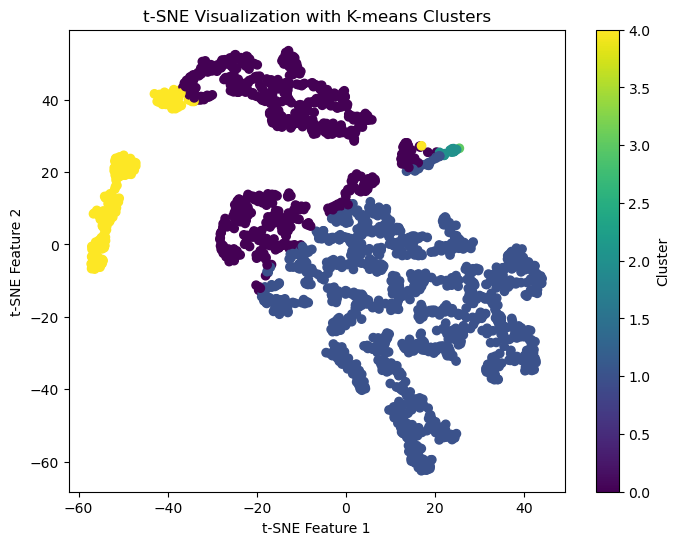

In [10]:
"""
t-SNE with K-Means (continuous legend)
"""
# selecting shape and texture features for analysis
features = ['circularity_hu', 'raw_convex_hull_area']  # Replace with your actual features

# standardizing the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df[features])

# apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=0)
clusters = kmeans.fit_predict(scaled_features)

# apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=0)
tsne_results = tsne.fit_transform(scaled_features)

# plotting the results of t-SNE with cluster labels (continous)
plt.figure(figsize=(8, 6))
plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=clusters, cmap='viridis')
plt.title("t-SNE Visualization with K-means Clusters")
plt.xlabel("t-SNE Feature 1")
plt.ylabel("t-SNE Feature 2")
plt.colorbar(label='Cluster')
plt.show()

In [11]:
"""
This cluster seems to have a lot of the "empty" images in it.

Explore if the ones of actual cells are from the cluster that has multiple classes in it.
"""
# choose cluster of interest
target_cluster = 1 

# filter the dataframe to get IDs of images in the target cluster
target_ids = df[clusters == target_cluster]['id']

image_directory = 'data\IN-All-Split\IN-2A'

num_images = len(target_ids)
cols = 8
rows = math.ceil(num_images / cols)

# create subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
axes = axes.flatten()

# loop through the images and display each one
for i, image_id in enumerate(target_ids):
    image_path = os.path.join(image_directory, f'IN-2A_{str(image_id).zfill(6)}.png')
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    axes[i].imshow(image)
    axes[i].set_title(f'ID: {image_id}', fontsize=12)
    axes[i].axis('off')

# Hide any unused subplots
for ax in axes[num_images:]:
    ax.axis('off')

# Adjust layout
plt.tight_layout(pad=0.2, h_pad=0.5, w_pad=0.5)
plt.show()

### Feature Matching in Images

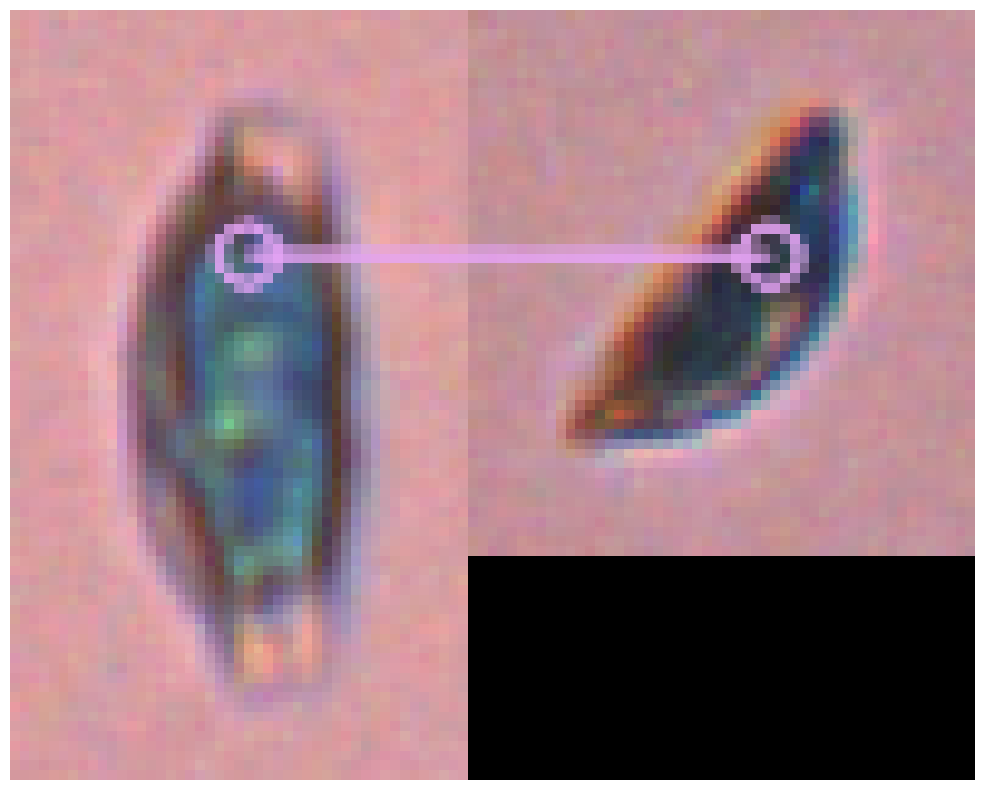

In [12]:
# load specific images for testing
# color_img1 = cv2.imread('data/IN-All-Split/IN-2A/IN-2A_000010.png', cv2.COLOR_BGR2GRAY)  # query image
# color_img2 = cv2.imread('data/IN-All-Split/IN-2A/IN-2A_000011.png', cv2.COLOR_BGR2GRAY)  # train image
color_img1 = cv2.imread('data/IN-All-Split/IN-2A/IN-2A_000010.png', cv2.COLOR_BGR2GRAY)  # query image
color_img2 = cv2.imread('data/IN-All-Split/IN-2A/IN-2A_000056.png', cv2.COLOR_BGR2GRAY)  # train image

# convert the images to grayscale for feature detection
gray_img1 = cv2.cvtColor(color_img1, cv2.COLOR_BGR2GRAY)
gray_img2 = cv2.cvtColor(color_img2, cv2.COLOR_BGR2GRAY)

# initialize the SIFT detector
sift = cv2.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(gray_img1, None)
kp2, des2 = sift.detectAndCompute(gray_img2, None)

# create BFMatcher object with default parameters
bf = cv2.BFMatcher()

# match descriptors
matches = bf.knnMatch(des1, des2, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches.append([m])

# draw the matches
img_matches = cv2.drawMatchesKnn(color_img1, kp1, color_img2, kp2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

output_path = 'feature_matching_result_sift.png'
cv2.imwrite(output_path, img_matches)

plt.figure(figsize=(20, 10))
plt.imshow(img_matches)
plt.axis('off')
plt.show()


## Filtering Functions

In [13]:
"""
My current best algorithm to filter empty / unimportant cells

TLDR: We just see if there are any edges, if there are its a cell

When evaluating on Emma's detections, it only filters out 4 of her total classifications, so it works well enough currently to move forward.
"""
def filter_images_without_edges(directory_path):
    # construct the path to the CSV file based on the directory name
    #dir_name = Path(directory_path).name
    #csv_path = Path(directory_path) / f"{dir_name}_df.csv"

    # folders for categorized images
    cell_folder = Path(directory_path) / "cell"
    empty_folder = Path(directory_path) / "empty"
    cell_folder.mkdir(exist_ok=True)
    empty_folder.mkdir(exist_ok=True)

    # iterate through each image in the directory
    for filename in os.listdir(directory_path):
        if filename.endswith(".png"):
            file_path = os.path.join(directory_path, filename)

            # read the image and convert it to grayscale
            image = cv2.imread(file_path, cv2.IMREAD_COLOR)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            # edge detection
            edges = cv2.Canny(gray, 100, 200)

            # check for edges
            if edges.sum() > 0:
                # any edges = cell img
                shutil.copy(file_path, cell_folder)
            else:
                # no edges = no cell
                shutil.copy(file_path, empty_folder)

directory_path = "data\IN-2A\Exported Images"

filter_images_without_edges(directory_path)

#### Grouping Cells

In [14]:
def load_and_process_images(directory_path):
    images = {}
    sift = cv2.SIFT_create()
    for filename in os.listdir(directory_path):
        if filename.endswith(".png"):
            file_path = os.path.join(directory_path, filename)
            image = cv2.imread(file_path, cv2.IMREAD_COLOR)
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            kp, des = sift.detectAndCompute(gray, None)
            images[file_path] = (kp, des)
    return images

def find_similar_images(images, bf, match_threshold=15, max_similar_images=3):
    grouped_images = defaultdict(list)
    for file_path, (kp1, des1) in images.items():
        if des1 is None:
            continue
        for other_path, (kp2, des2) in images.items():
            if other_path == file_path or des2 is None:
                continue
            matches = bf.knnMatch(des1, des2, k=2)
            good_matches = [m for match in matches if len(match) == 2 and match[0].distance < 0.75 * match[1].distance]
            if len(good_matches) >= match_threshold:
                grouped_images[file_path].append(other_path)
        
        # Exclude the image if it has more than max_similar_images similar images
        if len(grouped_images[file_path]) > max_similar_images:
            del grouped_images[file_path]

    return grouped_images

# initialize BFMatcher
bf = cv2.BFMatcher()

# load and process images
directory_path = 'data\IN-2A\Exported Images\cell'
images = load_and_process_images(directory_path)

# find similar images and group them
image_groups = find_similar_images(images, bf, match_threshold=15, max_similar_images=3)


#### Visualize Groupings

In [15]:
def plot_similar_images(main_image_path, similar_images):
    plt.figure(figsize=(15, 10))

    main_image = cv2.cvtColor(cv2.imread(main_image_path), cv2.COLOR_BGR2RGB)
    plt.subplot(1, len(similar_images) + 1, 1)
    plt.imshow(main_image)
    plt.title("Main Image")
    plt.axis('off')

    for i, img_path in enumerate(similar_images, start=2):
        image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        plt.subplot(1, len(similar_images) + 1, i)
        plt.imshow(image)
        plt.title(f"Similar {i-1}")
        plt.axis('off')

    plt.show()

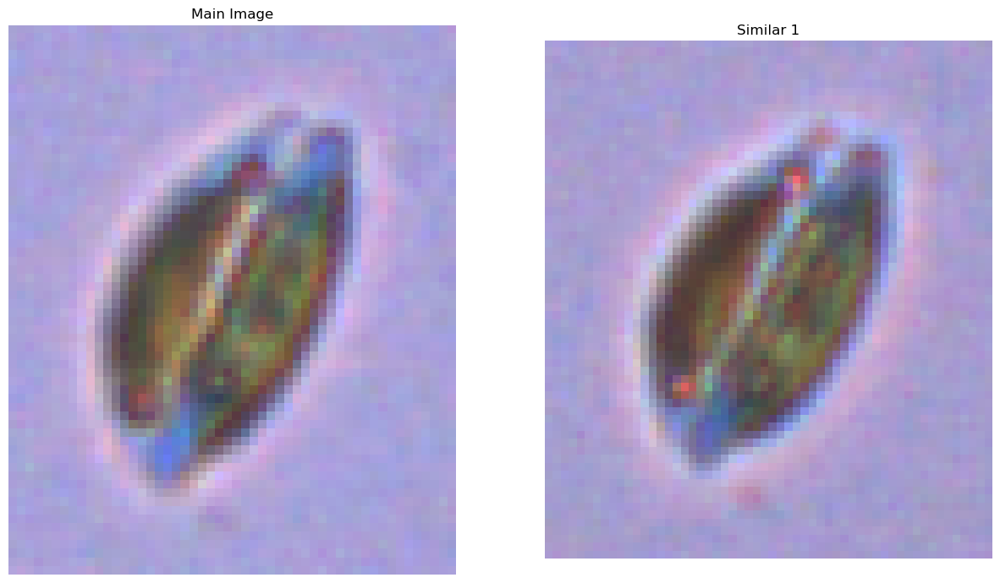

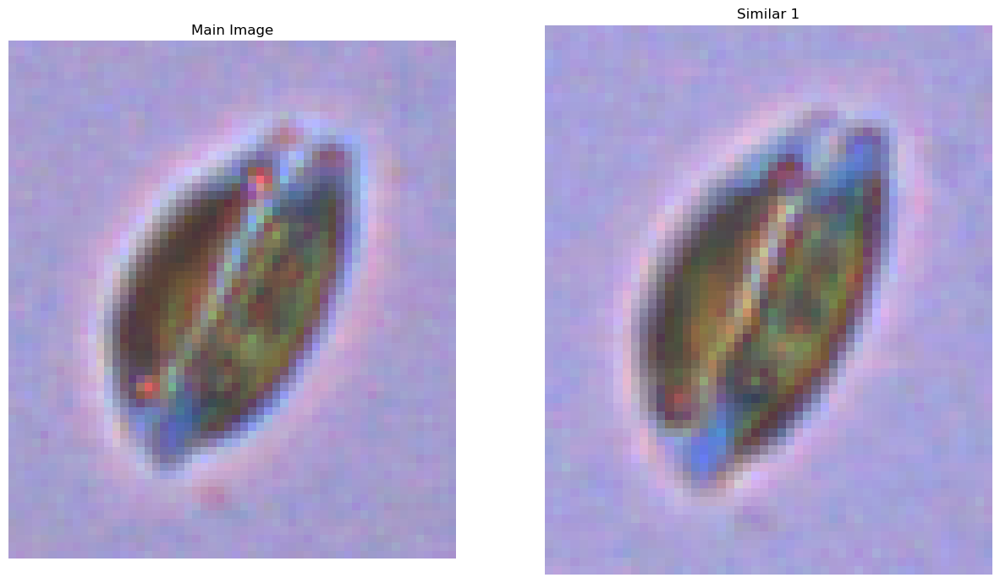

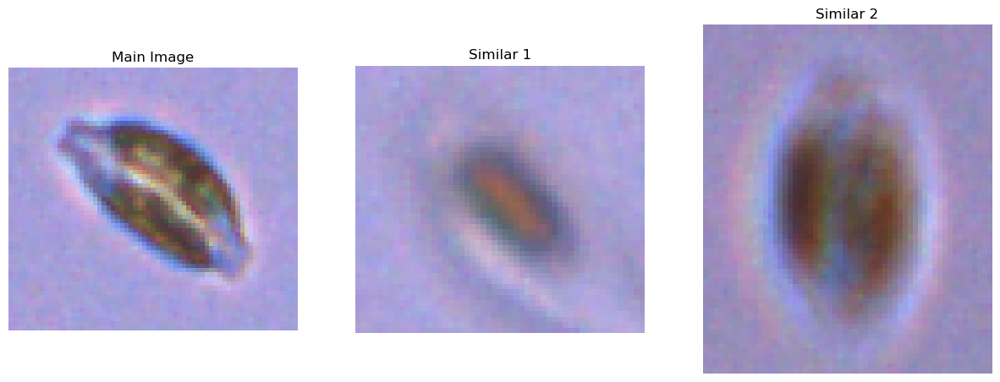

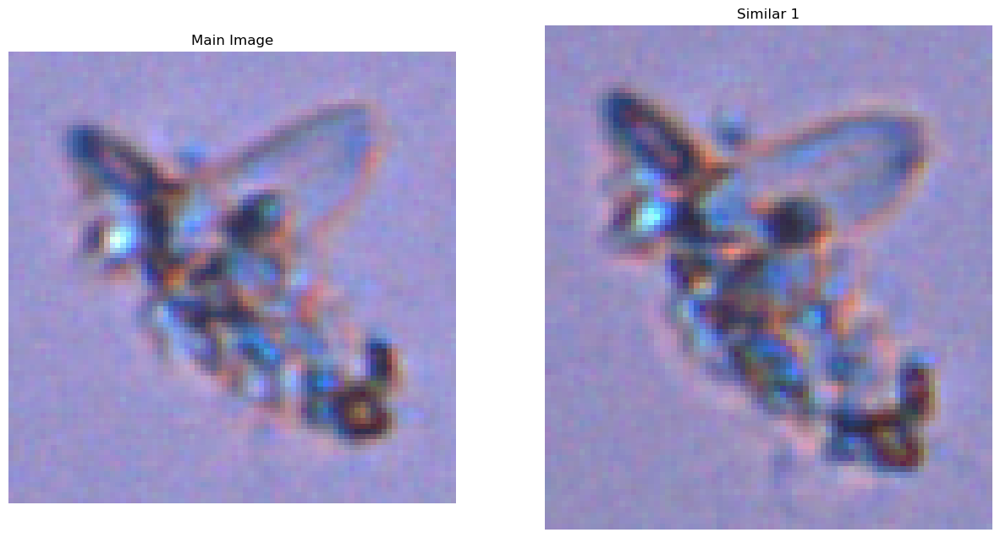

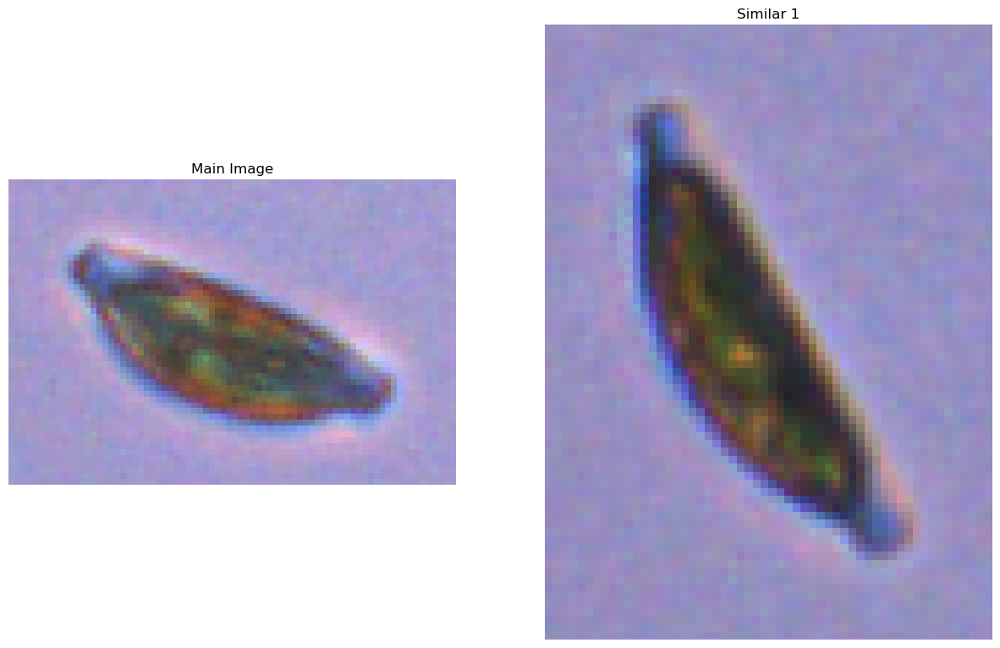

In [16]:
counter = 0
for main_image, similar_images in image_groups.items():
    if similar_images:
        plot_similar_images(main_image, similar_images)
        counter+=1
        if counter == 5:
            break

#### Continued t-SNE Analysis of Clustering

##### Plot t-SNE

c:\Users\trist\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


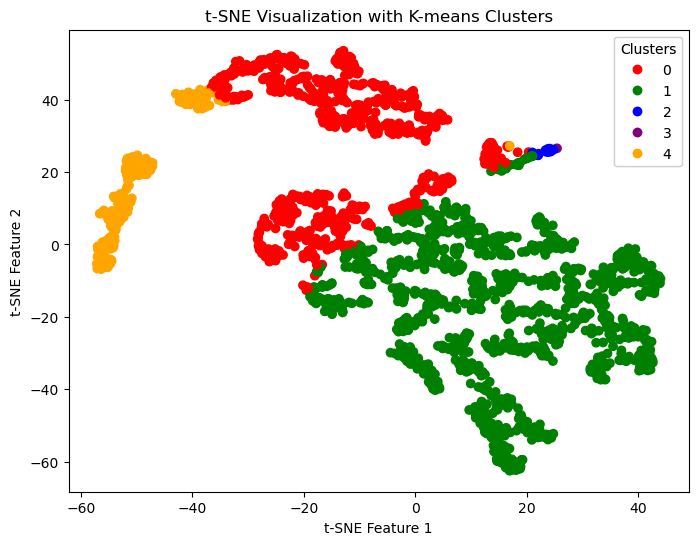

In [17]:
"""
t-SNE with K-Means (discrete legend)
"""
# selecting shape and texture features for analysis
features = ['circularity_hu', 'raw_convex_hull_area']

# standardizing the features
scaler = StandardScaler()
scaled_features = scaler.fit_transform(df[features])

# apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=0)
clusters = kmeans.fit_predict(scaled_features)

# apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=0)
tsne_results = tsne.fit_transform(scaled_features)

# plotting the results of t-SNE with cluster labels
plt.figure(figsize=(8, 6))

# define discrete colormap
colors = ['red', 'green', 'blue', 'purple', 'orange']
cmap = mcolors.ListedColormap(colors)

# scatter plot
scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], c=clusters, cmap=cmap)

# create a legend
legend1 = plt.legend(*scatter.legend_elements(),
                    loc="upper right", title="Clusters")
plt.gca().add_artist(legend1)

plt.title("t-SNE Visualization with K-means Clusters")
plt.xlabel("t-SNE Feature 1")
plt.ylabel("t-SNE Feature 2")
plt.show()

##### Plot 20 Results from Each Cluster

In [18]:
base_path = r"data\IN-2A\Exported Images"
prefix = "IN2-A 08-16-23 1-100 Dilution_"

image_paths = [os.path.join(base_path, f"{prefix}{str(id).zfill(5)}.png") for id in df['id']]

image_cluster_map = {image_path: cluster for image_path, cluster in zip(image_paths, clusters)}

In [19]:
selected_images_per_cluster = defaultdict(list)

for image_path, cluster_label in image_cluster_map.items():
    if len(selected_images_per_cluster[cluster_label]) < 20:
        selected_images_per_cluster[cluster_label].append(image_path)


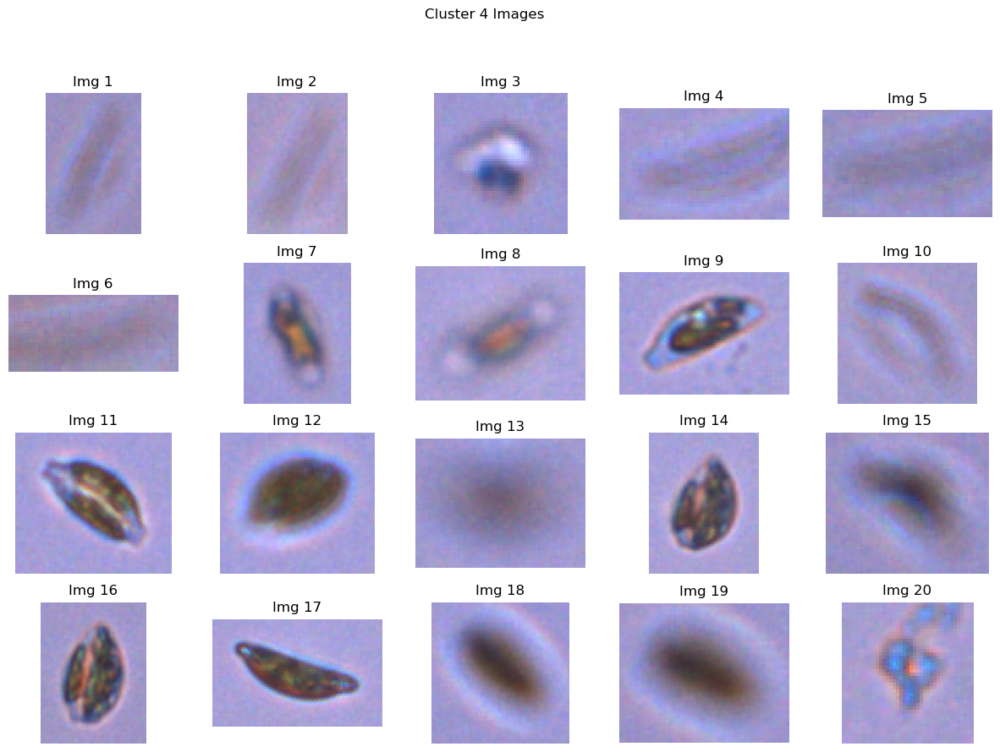

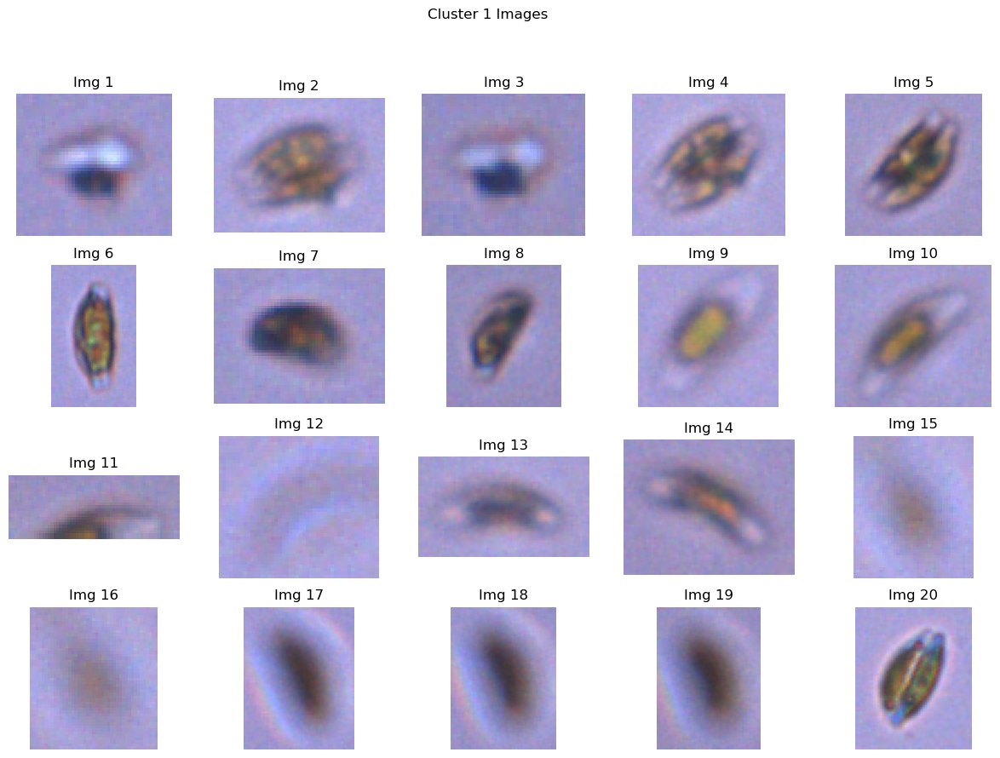

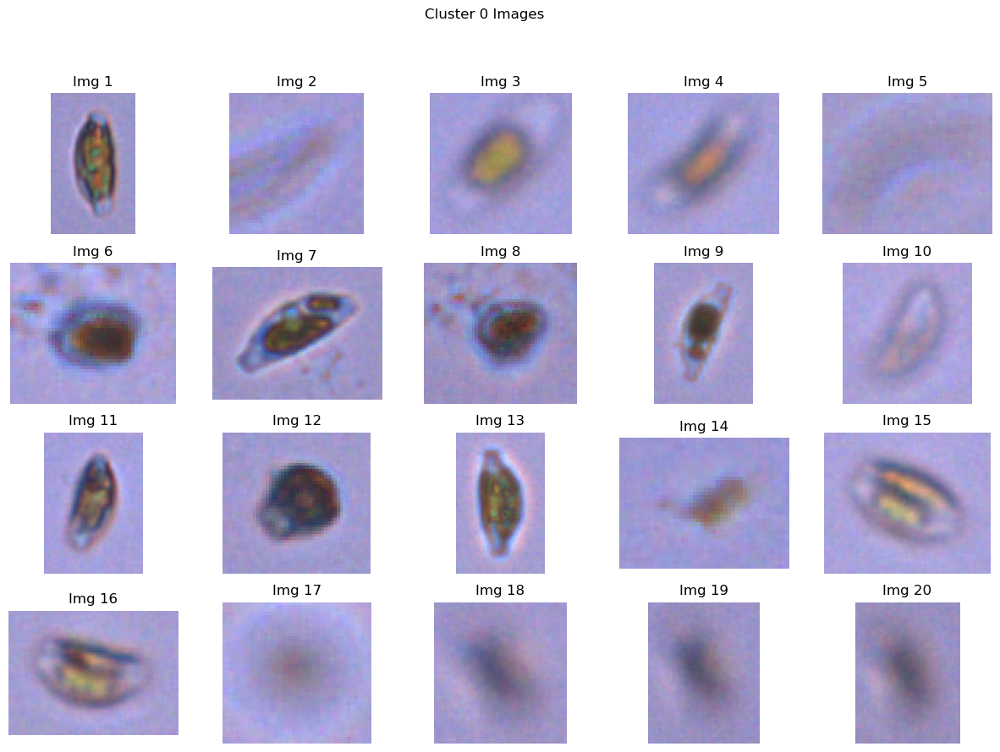

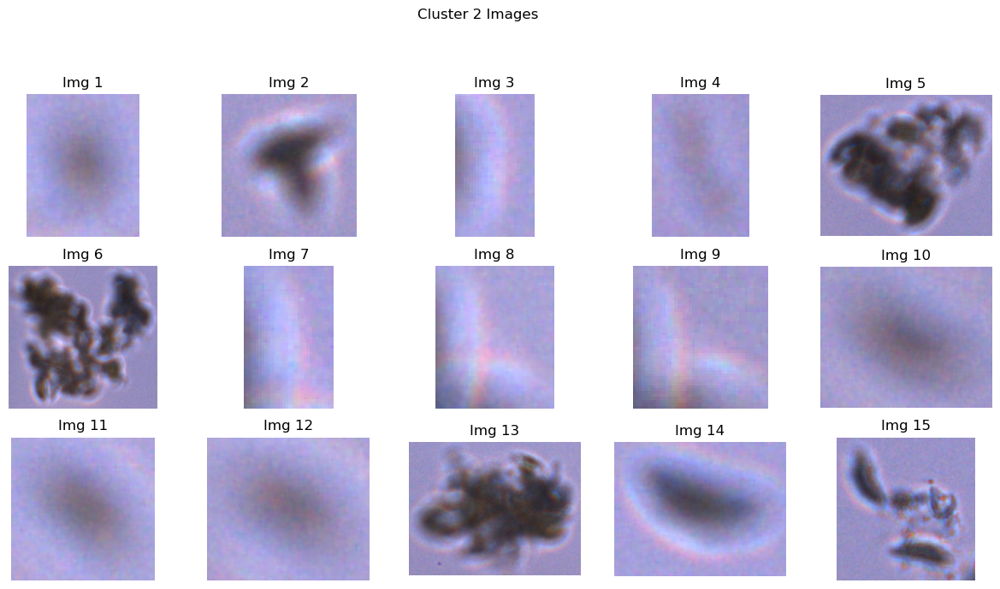

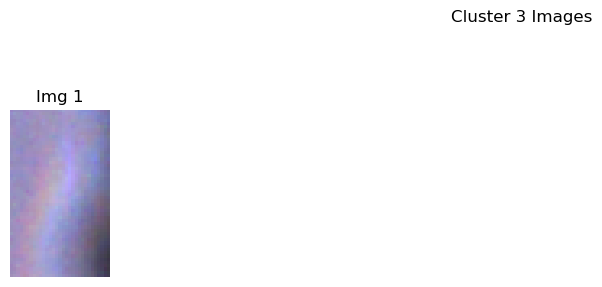

In [20]:
for cluster_label, image_paths in selected_images_per_cluster.items():
    plt.figure(figsize=(15, 10))
    plt.suptitle(f'Cluster {cluster_label} Images')
    for i, img_path in enumerate(image_paths):
        image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        plt.subplot(4, 5, i + 1)
        plt.imshow(image)
        plt.title(f"Img {i+1}")
        plt.axis('off')
    plt.show()

##### Ultimately there is nothing super noticable about the distinct clusters. K=5 since in Emma's manual annotations, she had 5 classes.

# It ends here. It's definitely true preprocessing is the bulk of work in ML.